# Data Processing

WIP

Y: categorical, 1 if median_house_value_2019/median_house_value_2016 > median ratio and median_house_value_2016 < median in 2016

X: 2016 values

In [5]:
from statistics import median
import pandas as pd
import sklearn
from sklearn.model_selection import train_test_split
import numpy as np
import os
import matplotlib as mpl
import seaborn as sb

feature_list_xlsx = ["CZA","CZB","CZD","CZH","CZM","CZV","PMC","TRF"]
feature_list_csv = ["EDU","MHI","new_housing","Public_Assistance_Rate","median_gross_rent","median_monthly_housing_costs",
"perc_below_poverty", "perc_college_grad","perc_hs_grad","perc_insured","perc_rental_housing","unemployment","vacancies","work_travel_time"]
path = os.path.join(os.getcwd(),'data_clean')
feature_values = pd.read_excel(os.path.join(path,'TRF_2016.xlsx'))
geoid = feature_values['GEOID']
dataframes = {}

# Read in feature values
year = 2016
df_dict = {}
df_dict['GEOID'] = geoid
for feature in feature_list_xlsx:
    file_name = feature + "_" + str(year) + '.xlsx'
    feature_values = pd.read_excel(os.path.join(path,file_name))
    df_dict[feature] = feature_values[file_name[:-5]]
for feature in feature_list_csv:
    file_name = feature + "_" + str(year) + '.csv'
    feature_values = pd.read_csv(os.path.join(path,file_name))
    df_dict[feature] = feature_values[file_name[:-4]]
dataframes[year] = pd.DataFrame(df_dict)

feature_values = pd.concat(dataframes.values(), ignore_index=True)
feature_values = feature_values.apply(pd.to_numeric, errors='coerce')

# Read in house values
house_values = pd.read_csv(os.path.join(path,'home_value.csv'))
renamed_geoid = []
for row in house_values['GEOID']:
    tract_num = (row.split(',')[0]).replace("Census Tract ",'')
    if ('.' in tract_num):
        if len(tract_num) == 6:
            tract_num = '0' + tract_num
        tract_num = '17031' + tract_num.replace('.','')
    else:
        if len(tract_num) == 3:
            tract_num = '0' + tract_num
        tract_num = '17031' + tract_num + '00'
    renamed_geoid.append(int(tract_num))

house_values['GEOID'] = renamed_geoid
house_values_2016 = house_values[house_values['YEAR'] == 2016]
house_values_2016 = house_values_2016.rename(columns = {"house_value": "house_value_2016"})
house_values_2019 = house_values[house_values['YEAR'] == 2019]
house_values_2019 = house_values_2019.rename(columns = {"house_value": "house_value_2019"})

median_house_val_ratio = house_values_2019['house_value_2019'].median() / house_values_2016['house_value_2016'].median()
median_house_val_2016 = house_values_2016['house_value_2016'].median()
#percentile_house_val_2016 = np.percentile(house_values_2016['house_value_2016'], 75)
#print(percentile_house_val_2016)
#print('median_house_val_2016', median_house_val_2016)
#print('median_house_val_ratio', median_house_val_ratio)

y_labels = pd.merge(house_values_2016, house_values_2019, on = ['GEOID'])
y_labels['ratio'] = y_labels['house_value_2019'] / y_labels['house_value_2016']
y_labels['label'] = np.where((y_labels['house_value_2016'] < median_house_val_2016) & (y_labels['ratio'] >  median_house_val_ratio), 1, 0)
y_labels = y_labels[['GEOID', 'label']]

# Create dataframe of feature and outcome values
df = pd.merge(y_labels, feature_values, on=['GEOID'])
col_dict = {'CZA': 'violent_crime',"CZB":"burglary","CZD":"drug_abuse",'CZH': 'aggravated_assault', "CZM": "major_crime", 
'CZV': 'homicide',"PMC":"pollution", 'TRF': 'traffic_intensity', 'EDU': 'college_enrolled','MHI': 'household_income', "new_housing":"new_housing",
"Public_Assistance_Rate":"public_assistance","median_gross_rent":"median_gross_rent","median_monthly_housing_costs":"median_monthly_housing_costs",
"perc_below_poverty":"perc_below_poverty", "perc_college_grad":"perc_college_grad","perc_hs_grad":"perc_hs_grad",
"perc_insured":"perc_insured","perc_rental_housing":"perc_rental_housing","unemployment":"unemployment",
"vacancies":"housing_vacancies","work_travel_time":"work_travel_time"}

feature_list = col_dict.values()

df = df.rename(columns = col_dict)
print(df)


           GEOID  label  violent_crime  burglary  drug_abuse  \
0    17031010100      0           21.0      20.0        13.0   
1    17031010201      0           23.0      26.0         9.0   
2    17031010202      1           13.0      10.0        14.0   
3    17031010300      0            9.0      15.0         4.0   
4    17031010400      0           15.0      20.0         5.0   
..           ...    ...            ...       ...         ...   
773  17031843500      1           10.0      17.0        12.0   
774  17031843600      0            5.0      28.0        15.0   
775  17031843700      0           19.0       0.0       169.0   
776  17031843800      0           37.0       2.0        17.0   
777  17031843900      0            9.0       0.0         0.0   

     aggravated_assault  major_crime  homicide  pollution  traffic_intensity  \
0                   1.0        153.0      34.0  11.449365           0.795343   
1                   2.0        157.0      49.0  11.507208          12.0

# Summary Statistics

In [6]:
df = df.drop('GEOID',1)
print(df.head())
print(df.describe())
print(df.dtypes)

   label  violent_crime  burglary  drug_abuse  aggravated_assault  \
0      0           21.0      20.0        13.0                 1.0   
1      0           23.0      26.0         9.0                 2.0   
2      1           13.0      10.0        14.0                 0.0   
3      0            9.0      15.0         4.0                 1.0   
4      0           15.0      20.0         5.0                 1.0   

   major_crime  homicide  pollution  traffic_intensity  college_enrolled  ...  \
0        153.0      34.0  11.449365           0.795343              24.0  ...   
1        157.0      49.0  11.507208          12.009642              24.6  ...   
2        296.0      47.0  11.494258          10.433684              36.0  ...   
3        139.0      29.0  11.482891           8.353382              38.2  ...   
4        140.0      28.0  11.521601          17.952882              77.7  ...   

   median_gross_rent  median_monthly_housing_costs  perc_below_poverty  \
0              872.0    

/tmp/ipykernel_188962/2336885365.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df = df.drop('GEOID',1)


In [7]:
print(df.dtypes)

label                             int64
violent_crime                   float64
burglary                        float64
drug_abuse                      float64
aggravated_assault              float64
major_crime                     float64
homicide                        float64
pollution                       float64
traffic_intensity               float64
college_enrolled                float64
household_income                float64
new_housing                     float64
public_assistance               float64
median_gross_rent               float64
median_monthly_housing_costs    float64
perc_below_poverty              float64
perc_college_grad               float64
perc_hs_grad                    float64
perc_insured                    float64
perc_rental_housing             float64
unemployment                    float64
housing_vacancies               float64
work_travel_time                float64
dtype: object


The dataframe comprises 2557 observations, where each observation contains the median house value (outcome variable) and 9 feature variables for a given census tract and year. The variables will be split 80:20, so that 80% of the data is in the training dataset and 20% is in the testing dataset.

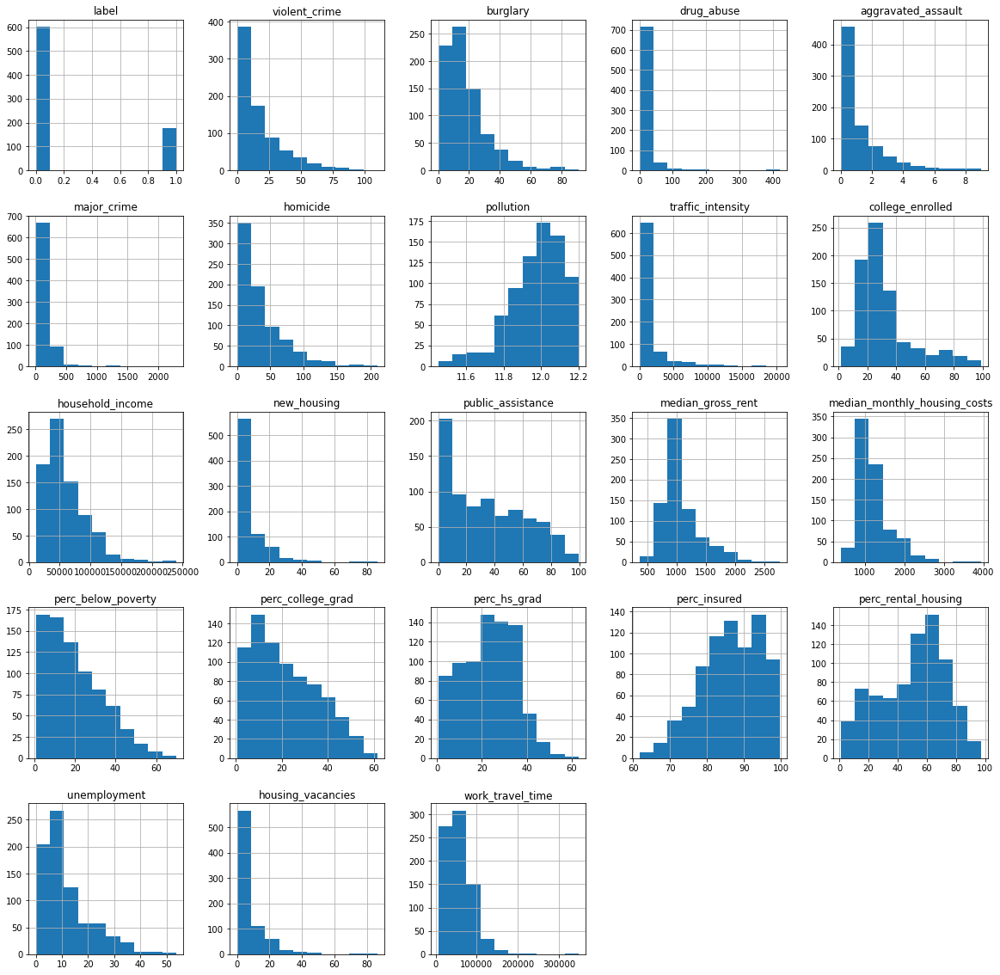

In [8]:
%matplotlib inline
import matplotlib.pyplot as plt

df.hist(figsize=(20,20))
plt.show()

From plotting the distribution of the feature values, we observe that features vary significantly in scale, so we will be normalizing the feature parameters. We can also observe that features such as assault and traffic instensity are significantly skewed with most values being in the lowest value bucket, as such, we have concerns that there may no be enough variation in those features to be valuable for the model. We fortunately do not observe any outliers that would need to be excluded.

label                           1.000000
public_assistance               0.251763
perc_hs_grad                    0.240466
violent_crime                   0.225834
perc_below_poverty              0.225171
homicide                        0.214126
unemployment                    0.204700
pollution                       0.181541
aggravated_assault              0.177151
drug_abuse                      0.152033
burglary                        0.130476
perc_rental_housing             0.066424
major_crime                     0.042075
work_travel_time               -0.049640
housing_vacancies              -0.090551
new_housing                    -0.090551
traffic_intensity              -0.104612
perc_insured                   -0.169505
median_gross_rent              -0.180190
median_monthly_housing_costs   -0.180924
college_enrolled               -0.195123
household_income               -0.208311
perc_college_grad              -0.278521
Name: label, dtype: float64


<AxesSubplot:>

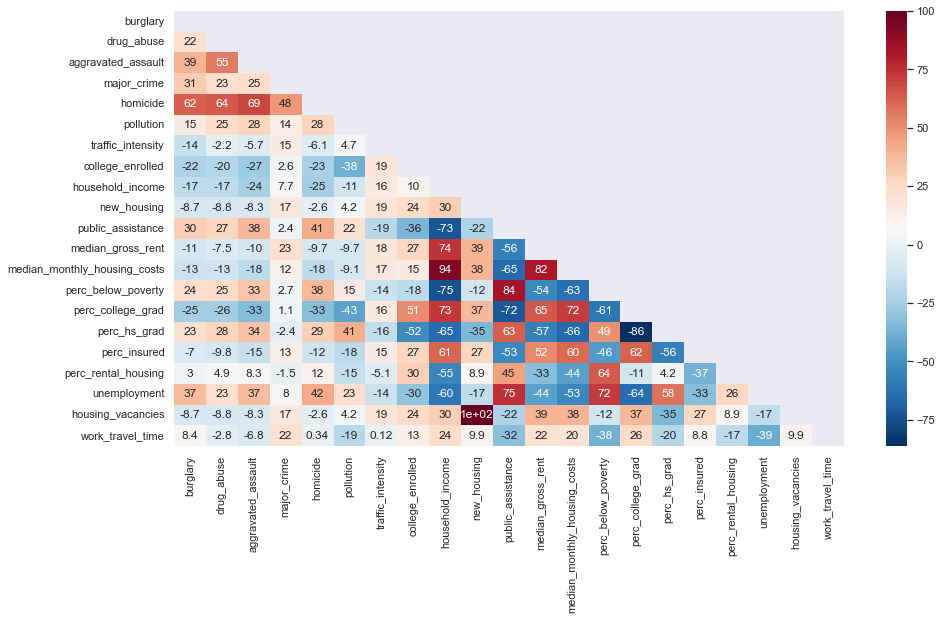

In [9]:
corr_matrix = df.corr()
print(corr_matrix["label"].sort_values(ascending=False))
mask = np.zeros_like(df.iloc[:,2:].corr(), dtype=bool)
mask[np.triu_indices_from(mask)] = True
sb.set(rc = {'figure.figsize':(15,8)})
sb.heatmap(df.iloc[:,2:].corr()*100, cmap='RdBu_r', annot = True, mask=mask)

Based on the heat map of the correlations of features, we can see that there is a positive correlation between housing price and median household income for an area, as well as the percent of the population enrolled in college. We can also observe a strong negative correlation between household price and unemployment levels and crime levels in the area. There is strong correlation between the crime features, which my make it worth combining them into a single feature.

# Feature Engineering

In [10]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

X = df.drop('label', 1)
y = df['label']

imputer = SimpleImputer(strategy="median")

# Replace NA feature values with feature median
for feature in feature_list:
    col_ave = X[feature].median()
    X[feature].fillna(value = col_ave, inplace = True)

# Attempted combining variables, but models did not change from collapsing crime measures, and deterioriated from collapsing crime and poverty measures
# Collapse crime and poverty measures into one variable each
# X['crime_rate'] = X['violent_crime'] + X['aggravated_assault'] + X['homicide']
# X = X.drop(['violent_crime','aggravated_assault','homicide'],1)

# X['poverty_index'] = X['poverty_rate'] + X['rental_rate'] + X['unemploy_rate']
# X = X.drop(['poverty_rate','rental_rate','unemploy_rate'],1)

#feature_list = ['traffic_intensity', 'college_rate','household_income','poverty_rate','rental_rate','unemploy_rate','crime_rate']

# Scale all features
num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('std_scaler', StandardScaler()),
    ])
X_trans = (num_pipeline.fit_transform(X))

train_x, test_x, train_y, test_y = train_test_split(X_trans, y.to_numpy(), test_size=0.2, random_state=123)

/tmp/ipykernel_188962/1812678747.py:6: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  X = df.drop('label', 1)


# Model Training

### Linear Regression

In [12]:
### PROBABLY REMOVE SINCE OUR Y IS NOW BINARY

from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, accuracy_score
from sklearn.model_selection import cross_val_score

def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

lin_reg = LinearRegression()
lin_reg.fit(train_x, train_y)
lin_predictions = lin_reg.predict(train_x)
lin_mse = mean_squared_error(train_y, lin_predictions)  
lin_rmse = np.sqrt(lin_mse) 
print(lin_rmse)
#print(mean_absolute_error(train_y, lin_predictions))

# Cross validation
lin_scores = cross_val_score(lin_reg, train_x, train_y, scoring="neg_mean_squared_error", cv=10)
lin_rmse_scores = np.sqrt(-lin_scores)
display_scores(lin_rmse_scores)

0.3922475393690197
Scores: [0.41608865 0.40521196 0.47957791 0.44873321 0.39224673 0.33742337
 0.40120553 0.40881412 0.35610455 0.4141115 ]
Mean: 0.40595175250203563
Standard deviation: 0.03849724618910656


### Decision Trees

In [13]:
from sklearn.tree import DecisionTreeClassifier

tree_reg = DecisionTreeClassifier(random_state=123)
tree_reg.fit(train_x, train_y)
dt_predictions = tree_reg.predict(train_x)
scores = cross_val_score(tree_reg, train_x, train_y, scoring="accuracy", cv=10)

tree_accuracy = accuracy_score(train_y, dt_predictions)
print(tree_accuracy)

1.0


### Support Vector Machine

In [14]:
from sklearn.svm import SVC

svm_reg = SVC(kernel="linear")
svm_reg.fit(train_x, train_y)
svm_predictions = svm_reg.predict(train_x)

svm_accuracy = accuracy_score(train_y, svm_predictions)
print(svm_accuracy)

0.7733118971061094


### Random Forest

In [15]:
from sklearn.ensemble import RandomForestClassifier

forest_reg = RandomForestClassifier(random_state=123)
forest_reg.fit(train_x, train_y)
forest_predictions = forest_reg.predict(train_x)
scores = cross_val_score(forest_reg, train_x, train_y, scoring="accuracy", cv=10)

forest_accuracy = accuracy_score(train_y, forest_predictions)
print(forest_accuracy)

1.0


### Gradient Boosted Trees

In [16]:
from sklearn.ensemble import GradientBoostingClassifier

boosted_reg = GradientBoostingClassifier(n_estimators=100, random_state=123)
boosted_reg.fit(train_x, train_y)
boosted_predictions = boosted_reg.predict(train_x)

boosted_scores = cross_val_score(boosted_reg, train_x, train_y, scoring="accuracy", cv=10)

boosted_accuracy = accuracy_score(train_y, boosted_predictions)
print(boosted_accuracy)

0.9581993569131833


### Logistic Regression

In [17]:
from sklearn.linear_model import LogisticRegression

logisticRegr = LogisticRegression()
logisticRegr.fit(train_x, train_y)
logisticRegr_predictions = logisticRegr.predict(train_x)

logisticRegr_scores = cross_val_score(logisticRegr, train_x, train_y,scoring="accuracy", cv=10)

#accuracy
logisticReg_accuracy = accuracy_score(train_y, logisticRegr_predictions)
print(logisticReg_accuracy)

0.7717041800643086


# Fine Tuning Model Using Grid Search

In [18]:
from sklearn.model_selection import GridSearchCV
param_grid = [
    # try 12 (3×4) combinations of hyperparameters
    {'n_estimators': [50, 100, 200, 500], 'max_features': [3,4,5,7], 'max_depth': [2,4,6,10,None]},
    # then try 6 (2×3) combinations with bootstrap set as False
    {'bootstrap': [False], 'n_estimators': [5, 10, 50, 100], 'max_features': [2, 8, 10, 20], 'max_depth': [2,4,6,10,None]},
  ]
forest_reg = RandomForestClassifier(random_state=42)
# train across 5 folds, that's a total of (12+6)*5=90 rounds of training 
grid_search = GridSearchCV(forest_reg, param_grid, cv=5,
                           scoring='accuracy',
                           return_train_score=True)
grid_search.fit(train_x, train_y)
print(grid_search.best_params_)

cvres = grid_search.cv_results_

feature_importances = grid_search.best_estimator_.feature_importances_
print(sorted(zip(feature_importances, feature_list), reverse=True))


{'bootstrap': False, 'max_depth': 4, 'max_features': 8, 'n_estimators': 100}
[(0.13554062402297315, 'perc_college_grad'), (0.11833396663629184, 'pollution'), (0.09513098400303974, 'household_income'), (0.09229476120797876, 'unemployment'), (0.0828074127298028, 'drug_abuse'), (0.06320914755546315, 'violent_crime'), (0.05071749821100787, 'homicide'), (0.04527968541342692, 'traffic_intensity'), (0.03737018358567118, 'median_monthly_housing_costs'), (0.029200911311729444, 'major_crime'), (0.028525419746045645, 'new_housing'), (0.02736160090115058, 'perc_rental_housing'), (0.0256612956296431, 'perc_hs_grad'), (0.024315527883935727, 'housing_vacancies'), (0.024231123649516503, 'work_travel_time'), (0.023794403753268894, 'college_enrolled'), (0.0234774644840983, 'public_assistance'), (0.02154239409836484, 'perc_insured'), (0.01788113698117106, 'perc_below_poverty'), (0.017414172212002782, 'burglary'), (0.013011865994865807, 'median_gross_rent'), (0.002898419988551919, 'aggravated_assault')]


# Model Evaluation

In [19]:
final_model = grid_search.best_estimator_
final_predictions = final_model.predict(test_x)

#final_mse = mean_squared_error(test_y, final_predictions)
#final_rmse = np.sqrt(final_mse)
#print("rmse:", final_rmse)
#print("R^2:", r2_score(test_y, final_predictions))
#print("MAE:", mean_absolute_error(test_y, final_predictions))


final_accuracy = accuracy_score(test_y, final_predictions)
print(final_accuracy)


# # Computing 95% confidence interval
# from scipy import stats
# confidence = 0.95
# squared_errors = (final_predictions - test_y) ** 2
# np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
#                          loc=squared_errors.mean(),
#                          scale=stats.sem(squared_errors)))

# forest_reg = RandomForestRegressor(n_estimators=50, random_state=123)
# forest_reg.fit(train_x, train_y)
# final_predictions = forest_reg.predict(test_x) 
# final_mse = mean_squared_error(test_y, final_predictions)
# final_rmse = np.sqrt(final_mse)
# print("rmse:", final_rmse)
# print("R^2:", r2_score(test_y, final_predictions))
# print("MAE:", mean_absolute_error(test_y, final_predictions))

0.7884615384615384


## Our Classification of Gentrifying

In [97]:
import json
import plotly.express as px
with open(os.path.join(os.getcwd(),'tracts.geojson')) as file:
       tracts = json.load(file)
    
fig = px.choropleth_mapbox(y_labels, geojson=tracts, locations='GEOID', 
                               featureidkey="properties.geoid10",
                               color = y_labels['label'],                                 
                               mapbox_style="carto-positron",
                               zoom=9, center = {"lat": 41.81, "lon": -87.7},
                               opacity=0.5,
                               labels={})

fig.show()

## At Risk Areas According to Urban Displacement Project

In [23]:
displ = pd.read_csv(os.path.join(path, "chicago.csv"))

displ['binary'] = 'Stable'
displ.loc[displ['Typology'] == 'At Risk of Gentrification', 'binary'] = 'At Risk'
displ.loc[displ['Typology'] == 'Early/Ongoing Gentrification', 'binary'] = 'At Risk'
displ.loc[displ['Typology'] == 'Low-Income/Susceptible to Displacement', 'binary'] = 'At Risk'
displ.loc[displ['Typology'] == 'Ongoing Displacement', 'binary'] = 'At Risk'

fig2 = px.choropleth_mapbox(displ, geojson=tracts, locations='GEOID', 
                                featureidkey="properties.geoid10",
                                color = displ['binary'],                                 
                                mapbox_style="carto-positron",
                                zoom=9, center = {"lat": 41.81, "lon": -87.7},
                                opacity=0.5,
                                labels={})

fig2.show()

## ROC Curve

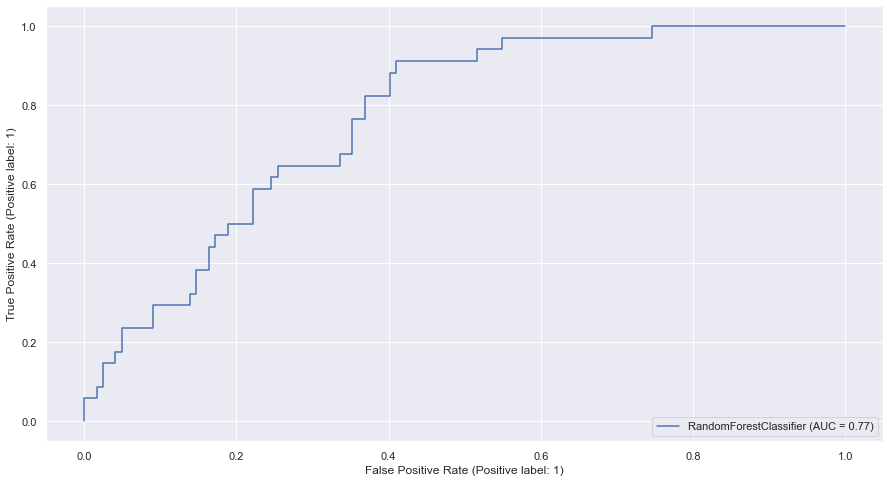

In [95]:
from sklearn.metrics import RocCurveDisplay
ROC = RocCurveDisplay.from_estimator(final_model, test_x, test_y)

## Overfitting Curve

Text(0, 0.5, 'Error Rate')

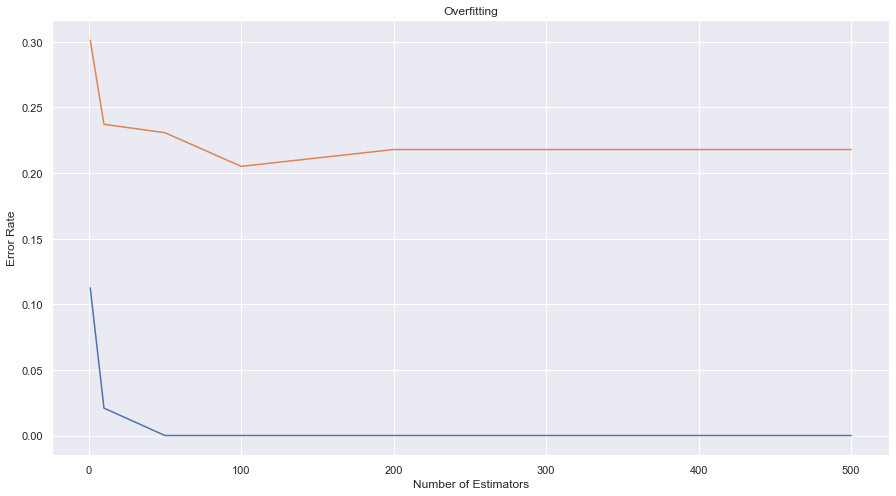

In [90]:
n_est = [1, 10, 50, 100, 200, 500]
train_acc = []
test_acc = []
for n in n_est:
    RF = RandomForestClassifier(n_estimators = n)
    RF.fit(train_x, train_y)
    train_pred = RF.predict(train_x)
    train_acc.append(1-(accuracy_score(train_y, train_pred)))
    test_pred =  RF.predict(test_x)
    test_acc.append(1-accuracy_score(test_y, test_pred))
    
    
plt.title("Overfitting")
ax = plt.subplot()
plt.plot(n_est, train_acc)
plt.plot(n_est, test_acc)
ax.set_xlabel('Number of Estimators')
ax.set_ylabel('Error Rate')

## Feature Importance

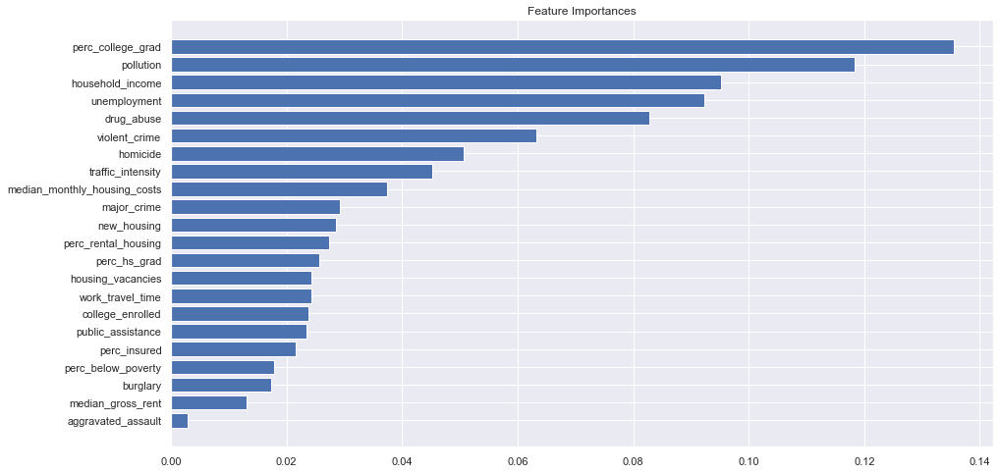

In [25]:
ind = np.argsort(-feature_importances)

x = range(train_x.shape[1])
y = feature_importances[ind][:train_x.shape[1]]

plt.title("Feature Importances")
ax = plt.subplot()
plt.barh(x, y)
ax.set_yticks(x)
ax.set_yticklabels(X.columns[ind])
plt.gca().invert_yaxis()